In [1]:
# 共通で利用するライブラリ
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display, Image, HTML

warnings.filterwarnings('ignore')
np.set_printoptions(suppress=True, precision=4)
pd.options.display.float_format = '{:.4f}'.format
pd.set_option("display.max_columns", None)
plt.style.use('seaborn')
plt.rcParams["font.size"] = 14
plt.rcParams['font.family'] = 'IPAexGothic'

# この章で利用するライブラリ
import cv2
from matplotlib.animation import FuncAnimation
import dlib
import math

# 9章 潜在顧客を把握するための画像認識１０本

ここでは、カメラから取得した映像を用いて画像認識を行う。  
必要な情報を取得するための流れを学ぶ。  
画像認識をビジネス現場で応用するイメージをつかむ。

データ一覧

- img/img01.jpg
  - 道路の通行人の画像（道路全体）
- img/img01.jpg
  - 道路の通行人の上半身の画像（別シーン）
- mov/mov01.avi
  - 道路の通行人の画像（その1）
- mov/mov01.avi
  - 道路の通行人の画像（その2）

### Knock81: 画像データを読み込む

In [2]:
def f_imshow(img):
    """画像をNotebook上のインラインに表示する"""
    img = cv2.imencode(".png", img)[1]
    display(Image(img))

画像幅: 1920
画像高さ: 1440


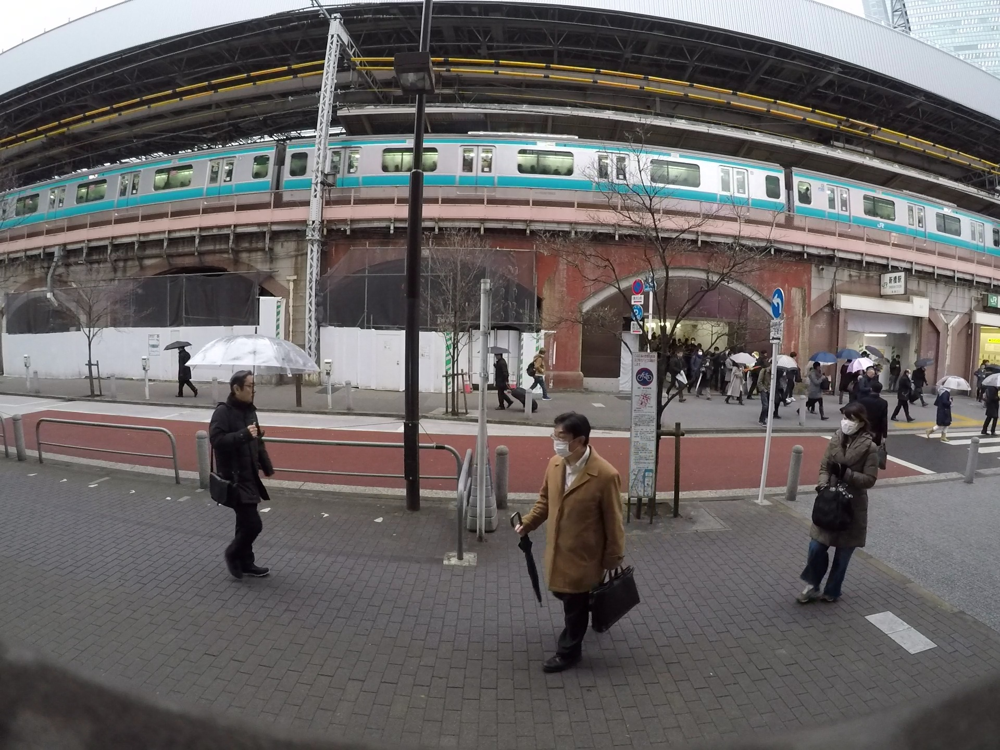

In [3]:
# img/img01.jpgの読み込み

img = cv2.imread("../support/9章/img/img01.jpg")
height, width = img.shape[:2]
print(f"画像幅: {width}")
print(f"画像高さ: {height}")

f_imshow(img)

### Knock82: 映像データを読み込む

In [4]:
# mov/mov01.aviの読み込み

# 情報取得
cap = cv2.VideoCapture("../support/9章/mov/mov01.avi")
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
count = cap.get(cv2.CAP_PROP_FRAME_COUNT)
fps = cap.get(cv2.CAP_PROP_FPS)
print(f"画像幅: {width}")
print(f"画像高さ: {height}")
print(f"総フレーム数: {count}")
print(f"FPS: {fps}")

# 映像のフレーム画像化
num = 0
num_frame = 100
list_frame = []
while(cap.isOpened()):
    # 処理（フレームごとに切り出し）
    ret, frame = cap.read()
    # 出力（フレーム画像を書き出し）
    if ret:
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        list_frame.append(frame_rgb)
        if cv2.waitKey(1) & 0xFF == ord("q"):
            break
        if num > num_frame:
            break
    num += 1
print("処理を完了しました。")
cap.release()

# 画像フレームをアニメーションに変換
plt.figure()
patch = plt.imshow(list_frame[0])
plt.axis("off")

def animate(i):
    patch.set_data(list_frame[i])

anim = FuncAnimation(plt.gcf(), animate, frames=len(list_frame), interval=1000/30.0)
plt.close()

# アニメーション表示
HTML(anim.to_jshtml())

画像幅: 1920.0
画像高さ: 1440.0
総フレーム数: 401.0
FPS: 30.0
処理を完了しました。


### Knock83: 映像を画像に分割して保存する

In [5]:
cap = cv2.VideoCapture("../support/9章/mov/mov01.avi")
num = 0
count = cap.get(cv2.CAP_PROP_FRAME_COUNT)
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        filepath = "snapshot/snapshot_" + str(num) + ".jpg"
        cv2.imwrite(filepath, frame)
        num += 1
        if num >= count:
            break
cap.release()
cv2.destroyAllWindows()

### Knock84: 画像内のどこに人がいるかを検出する

- HOG特徴量
- HOG（Histogram of Oriented Gradients）: 輝度勾配
  - 人のシルエットを見て、そのシルエットの形の特徴を、位置や角度で表現する

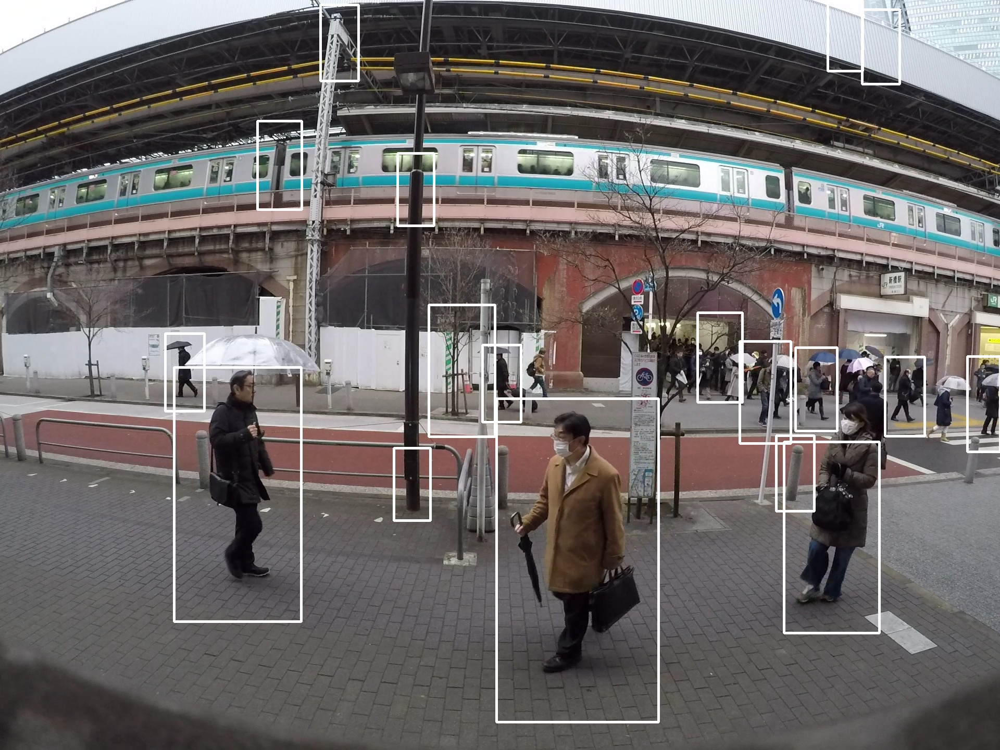

True

In [6]:
# 準備
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hog_params = {
    "winStride": (8, 8),
    "padding": (32, 32),
    "scale": 1.05,
    "hitThreshold": 0,
    # "finalThreshold": 5,
}

# 検出
img = cv2.imread("../support/9章/img/img01.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
human, r = hog.detectMultiScale(gray, **hog_params)
if len(human) > 0:
    for (x, y, w, h) in human:
        cv2.rectangle(img, (x, y), (x + w, y + h), (255, 255, 255), 3)

f_imshow(img)
cv2.imwrite("temp.jpg", img)

### Knock85: 画像内の人の顔を検出する

- CascadeClassifier

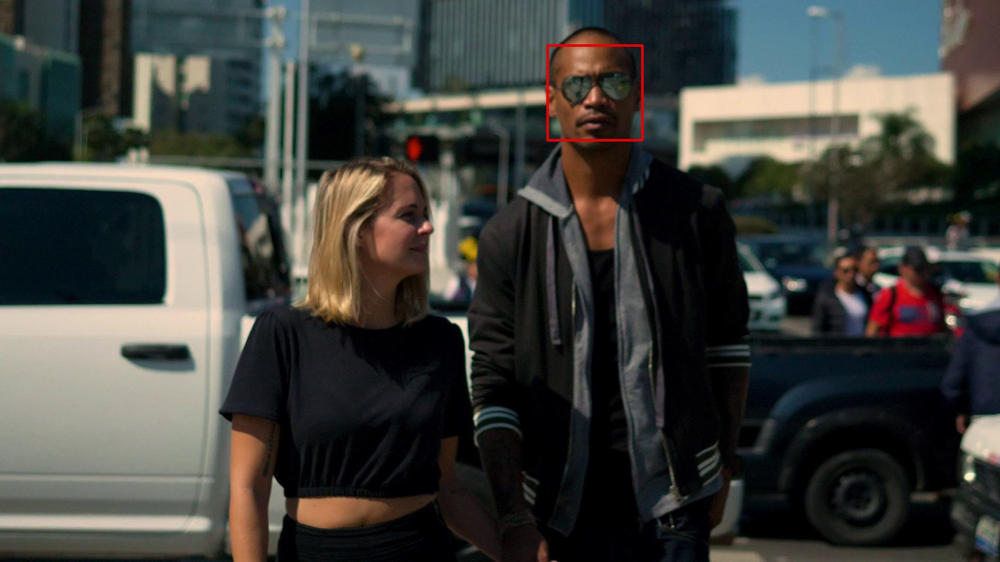

True

In [7]:
# 準備
cascade_file = "../support/9章/haarcascade_frontalface_alt.xml"
cascade = cv2.CascadeClassifier(cascade_file)

# 検出
img = cv2.imread("../support/9章/img/img02.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
face_list = cascade.detectMultiScale(gray, minSize=(50, 50))

# 検出した顔に印をつける
for (x, y, w, h) in face_list:
    color = (0, 0, 225)
    pen_w = 3
    cv2.rectangle(img, (x, y), (x + w, y + h), color, thickness=pen_w)

f_imshow(img)
cv2.imwrite("temp2.jpg", img)

### Knock86: 画像内の人がどこに顔を向けているかを検出する

顔器官No.0 座標位置: (1052,164)
顔器官No.1 座標位置: (1055,185)
顔器官No.2 座標位置: (1058,206)
顔器官No.3 座標位置: (1063,227)
顔器官No.4 座標位置: (1073,246)
顔器官No.5 座標位置: (1086,262)
顔器官No.6 座標位置: (1102,275)
顔器官No.7 座標位置: (1122,285)
顔器官No.8 座標位置: (1143,286)
顔器官No.9 座標位置: (1162,280)
顔器官No.10 座標位置: (1177,266)
顔器官No.11 座標位置: (1186,249)
顔器官No.12 座標位置: (1194,229)
顔器官No.13 座標位置: (1197,209)
顔器官No.14 座標位置: (1198,188)
顔器官No.15 座標位置: (1197,167)
顔器官No.16 座標位置: (1194,149)
顔器官No.17 座標位置: (1077,153)
顔器官No.18 座標位置: (1087,146)
顔器官No.19 座標位置: (1100,145)
顔器官No.20 座標位置: (1113,146)
顔器官No.21 座標位置: (1126,149)
顔器官No.22 座標位置: (1142,146)
顔器官No.23 座標位置: (1150,140)
顔器官No.24 座標位置: (1160,134)
顔器官No.25 座標位置: (1172,130)
顔器官No.26 座標位置: (1182,132)
顔器官No.27 座標位置: (1136,156)
顔器官No.28 座標位置: (1139,169)
顔器官No.29 座標位置: (1142,182)
顔器官No.30 座標位置: (1145,196)
顔器官No.31 座標位置: (1125,206)
顔器官No.32 座標位置: (1134,208)
顔器官No.33 座標位置: (1144,210)
顔器官No.34 座標位置: (1153,206)
顔器官No.35 座標位置: (1160,202)
顔器官No.36 座標位置: (1090,162)
顔器官No.37 座標位置: (1097,157)
顔器官No.38 座標位置: (1105,1

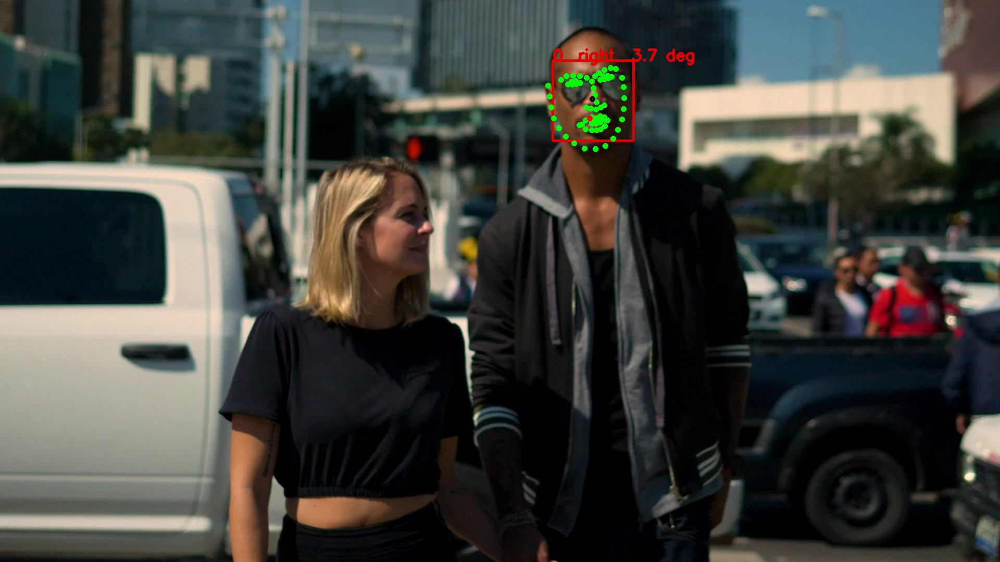

True

In [8]:
# 顔器官の検出

# 準備（モデルの読み込み）
predictor = dlib.shape_predictor("../support/9章/shape_predictor_68_face_landmarks.dat")
detector = dlib.get_frontal_face_detector()

# 検出
img = cv2.imread("../support/9章/img/img02.jpg")
dets = detector(img, 1)

for k, d in enumerate(dets):
    shape = predictor(img, d)

    # 顔領域の表示
    color_f = (0, 0, 225)
    color_l_out = (255, 0, 0)
    color_l_in = (0, 255, 0)
    line_w = 3
    circle_r = 3
    font_type = cv2.FONT_HERSHEY_SIMPLEX
    font_size = 1
    cv2.rectangle(img, (d.left(), d.top()), (d.right(), d.bottom()), color_f, line_w)
    cv2.putText(img, str(k), (d.left(), d.top()), font_type, font_size, color_f, line_w)

    # 重心を導出する箱を用意する
    num_of_points_out = 17
    num_of_points_in = shape.num_parts - num_of_points_out
    gx_out = 0
    gy_out = 0
    gx_in = 0
    gy_in = 0
    for shape_point_count in range(shape.num_parts):
        shape_point = shape.part(shape_point_count)
        print(f"顔器官No.{shape_point_count} 座標位置: ({shape_point.x},{shape_point.y})")
        # 器官ごとの描画
        if shape_point_count < num_of_points_out:
            cv2.circle(img, (shape_point.x, shape_point.y), circle_r, color_l_in, line_w)
            gx_out += shape_point.x / num_of_points_out
            gy_out += shape_point.y / num_of_points_out
        else:
            cv2.circle(img, (shape_point.x, shape_point.y), circle_r, color_l_in, line_w)
            gx_in += shape_point.x / num_of_points_in
            gy_in += shape_point.y / num_of_points_in

    # 重心位置を描画
    cv2.circle(img, (int(gx_out), int(gy_out)), circle_r, (0, 0, 255), line_w)
    cv2.circle(img, (int(gx_in), int(gy_in)), circle_r, (0, 0, 0), line_w)

    # 顔の方位を計算
    theta = math.asin(2 * (gx_in - gx_out) / (d.right() - d.left()))
    radian = theta * 180 / math.pi
    print(f"顔方位: {theta} (角度: {radian}度)")

    # 顔方位を表示
    if radian < 0:
        text_prefix = "   left "
    else:
        text_prefix = "   right "
    text_show = f"{text_prefix} {round(abs(radian), 1)} deg"
    cv2.putText(img, text_show, (d.left(), d.top()), font_type, font_size, color_f, line_w)

f_imshow(img)
cv2.imwrite("temp3.jpg", img)

### Knock87: 検出した情報を統合してタイムラプスを作る

- タイムラプス
  - 数フレームから1フレームのみを取り出した「早送り」動画

In [9]:
# 人の検出結果によるタイムラプスの作成

print("タイムラプスの生成を開始します。")

# 映像取得
cap = cv2.VideoCapture("../support/9章/mov/mov01.avi")
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# hog宣言
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hog_params = {
    "winStride": (8, 8),
    "padding": (32, 32),
    "scale": 1.05,
    "hitThreshold": 0,
    # "finalThreshold": 5,
}

# タイムラプス作成
movie_name = "timelapse.avi"
fourcc = cv2.VideoWriter_fourcc("X", "V", "I", "D")
video = cv2.VideoWriter(movie_name, fourcc, 30, (width, height))

num = 0
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        if num%10 == 0:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            human, r = hog.detectMultiScale(gray, **hog_params)
            if len(human) > 0:
                for (x, y, w, h) in human:
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 255, 255), 3)
            video.write(frame)
    else:
        break
    num += 1
video.release()
cap.release()
cv2.destroyAllWindows()
print("タイムラプス生成を終了しました。")

タイムラプスの生成を開始します。
タイムラプス生成を終了しました。


### Knock88: 全体像をグラフにして可視化する

In [11]:
# 人の検出結果をデータフレームに格納

print("分析を開始")

# 映像取得
cap = cv2.VideoCapture("../support/9章/mov/mov01.avi")
fps = cap.get(cv2.CAP_PROP_FPS)

# hog宣言
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hog_params = {
    "winStride": (8, 8),
    "padding": (32, 32),
    "scale": 1.05,
    "hitThreshold": 0,
    # "finalThreshold": 5,
}

num = 0
list_df = pd.DataFrame(columns=["time", "people"])
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        if num%10 == 0:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            human, r = hog.detectMultiScale(gray, **hog_params)
            if len(human) > 0:
                for (x, y, w, h) in human:
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 255, 255), 3)
            tmp_se = pd.Series([num / fps, len(human)], index=list_df.columns)
            list_df = list_df.append(tmp_se, ignore_index=True)
            if cv2.waitKey(1) & 0xFF == ord("q"):
                break
    else:
        break
    num += 1

cap.release()
cv2.destroyAllWindows()
print("分析終了")

分析を開始
分析終了


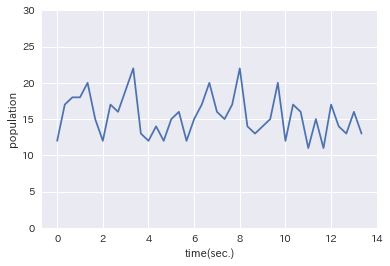

In [14]:
# データフレームの可視化

plt.plot(list_df["time"], list_df["people"])
plt.xlabel("time(sec.)")
plt.ylabel("population")
plt.ylim(0, 30)
plt.show()

### Knock89: 人通りの変化をグラフで確認する

In [21]:
# 人の検出結果をデータフレームに格納

print("分析開始")

# 映像の取得
cap = cv2.VideoCapture("../support/9章/mov/mov02.avi")
fps = cap.get(cv2.CAP_PROP_FPS)

# hog宣言
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hog_params = {
    "winStride": (8, 8),
    "padding": (32, 32),
    "scale": 1.05,
    "hitThreshold": 0,
    # "finalThreshold": 5,
}

num = 0
list_df2 = pd.DataFrame(columns=["time", "people"])
while(cap.isOpened):
    ret, frame = cap.read()
    if ret:
        if num%10 == 0:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            human, r = hog.detectMultiScale(gray, **hog_params)
            if len(human) > 0:
                for (x, y, w, h) in human:
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 255, 255), 3)
            tmp_se = pd.Series([num / fps, len(human)], index=list_df2.columns)
            list_df2 = list_df2.append(tmp_se, ignore_index=True)
            if cv2.waitKey(1) & 0xFF == ord("q"):
                break
    else:
        break
    num += 1

cap.release()
cv2.destroyAllWindows()
print("分析終了")

分析開始
分析終了


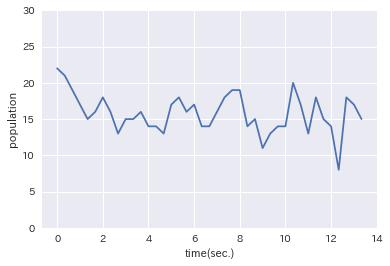

In [22]:
# データフレームの可視化

plt.plot(list_df2["time"], list_df2["people"])
plt.xlabel("time(sec.)")
plt.ylabel("population")
plt.ylim(0, 30)
plt.show()

### Knock90: 移動平均を計算することでノイズの影響を除去する

In [20]:
# 移動平均を計算

def moving_average(x, y):
    y_conv = np.convolve(y, np.ones(5) / float(5), mode="valid")
    x_dat = np.linspace(np.min(x), np.max(x), np.size(y_conv))

    return x_dat, y_conv

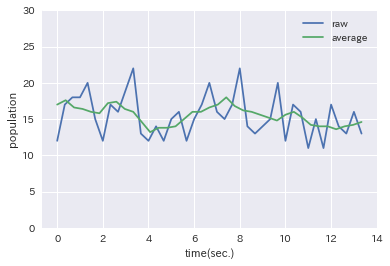

In [23]:
# mov/mov01.avi

plt.plot(list_df["time"], list_df["people"], label="raw")
ma_x, ma_y = moving_average(list_df["time"], list_df["people"])
plt.plot(ma_x, ma_y, label="average")
plt.xlabel("time(sec.)")
plt.ylabel("population")
plt.ylim(0, 30)
plt.legend()
plt.show()

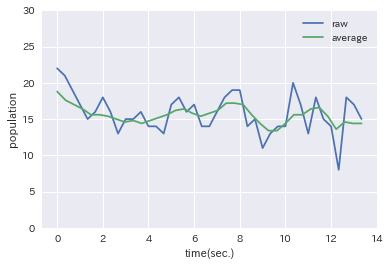

In [24]:
# mov/mov02.avi

plt.plot(list_df2["time"], list_df2["people"], label="raw")
ma_x2, ma_y2 = moving_average(list_df2["time"], list_df2["people"])
plt.plot(ma_x2, ma_y2, label="average")
plt.xlabel("time(sec.)")
plt.ylabel("population")
plt.ylim(0, 30)
plt.legend()
plt.show()


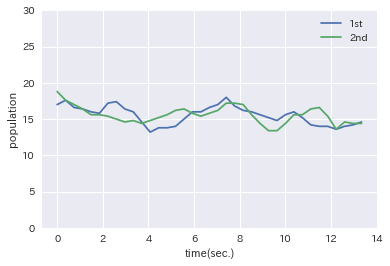

In [25]:
# 移動平均の比較

plt.plot(ma_x, ma_y, label="1st")
plt.plot(ma_x2, ma_y2, label="2nd")
plt.xlabel("time(sec.)")
plt.ylabel("population")
plt.ylim(0, 30)
plt.legend()
plt.show()